In [1]:
import tensorflow as tf
from tensorflow.keras import layers, losses, Model, optimizers, utils, preprocessing
import os
from matplotlib import pyplot as plt

In [2]:
from IPython.display import display


# Get Dataset

In [3]:
dataset_url = "http://www.eecs.berkeley.edu/Research/Projects/CS/vision/grouping/BSR/BSR_bsds500.tgz"
data_dir = utils.get_file(origin=dataset_url, fname="BSR", untar=True)
root_dir = os.path.join(data_dir, "BSDS500/data")

In [4]:
crop_size = 300
upscale_factor = 4
# input_size = crop_size // upscale_factor
input_size = crop_size
batch_size = 32

train_ds = preprocessing.image_dataset_from_directory(
    root_dir,
    batch_size=batch_size,
    image_size=(crop_size, crop_size),
    validation_split=0.2,
    subset="training",
    seed=1337,
    label_mode=None,
)

valid_ds = preprocessing.image_dataset_from_directory(
    root_dir,
    batch_size=batch_size,
    image_size=(crop_size, crop_size),
    validation_split=0.2,
    subset="validation",
    seed=1337,
    label_mode=None,
)

Found 500 files belonging to 1 classes.
Using 400 files for training.
Metal device set to: Apple M2

systemMemory: 8.00 GB
maxCacheSize: 2.67 GB

Found 500 files belonging to 1 classes.
Using 100 files for validation.


# Preprocessing the images

In [5]:
def scaling(input_image):
    input_image = input_image / 255.0
    return input_image


# Scale from (0, 255) to (0, 1)
train_ds = train_ds.map(scaling)
valid_ds = valid_ds.map(scaling)

In [6]:
# for batch in train_ds.take(1):
#     for img in batch:
#         display(utils.array_to_img(img))

In [7]:
def process_input(input, input_size, upscale_factor):
    downsample = tf.image.resize(input, [input_size//upscale_factor, input_size//upscale_factor], method="area")
    interpolate =  tf.image.resize(downsample, [input_size, input_size], method="bicubic")
    return interpolate

def process_target(input):
    # Identity mapping
    return input

train_ds = train_ds.map(
    lambda x: (process_input(x, input_size, upscale_factor), process_target(x))
)
train_ds = train_ds.prefetch(buffer_size=32)

valid_ds = valid_ds.map(
    lambda x: (process_input(x, input_size, upscale_factor), process_target(x))
)
valid_ds = valid_ds.prefetch(buffer_size=32)

2023-05-24 12:02:05.910912: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


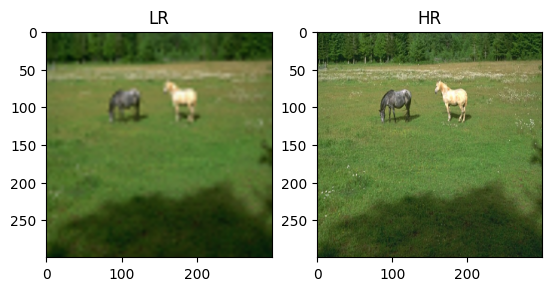

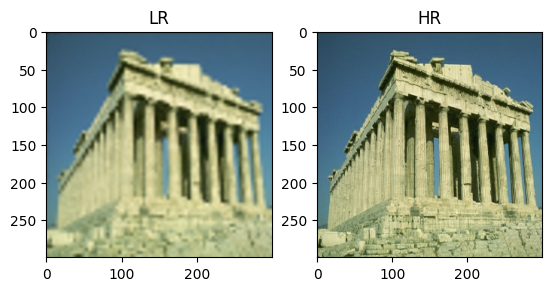

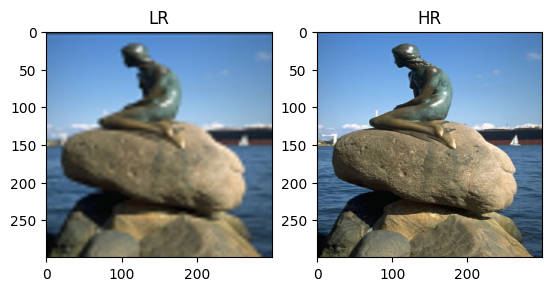

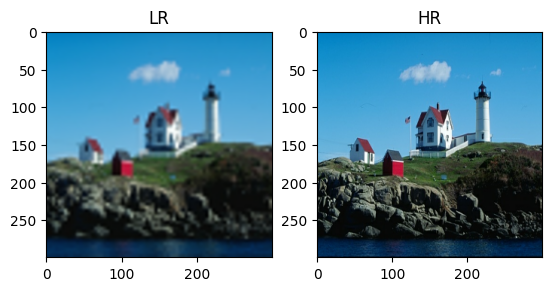

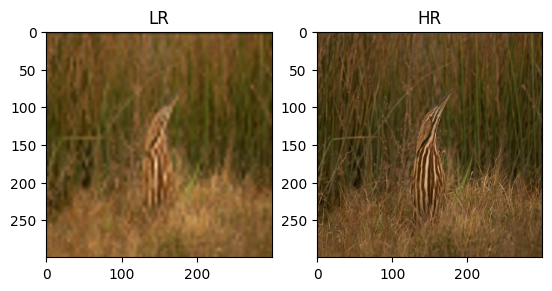

...

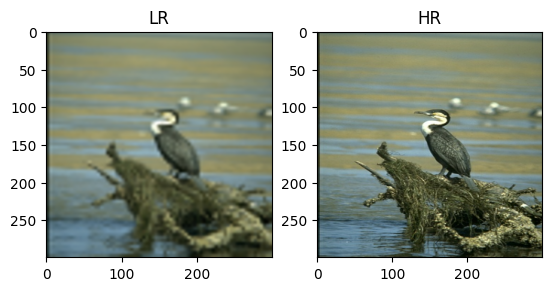

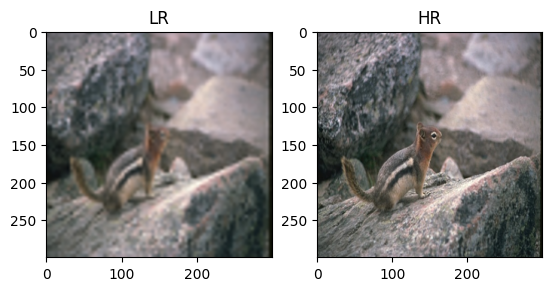

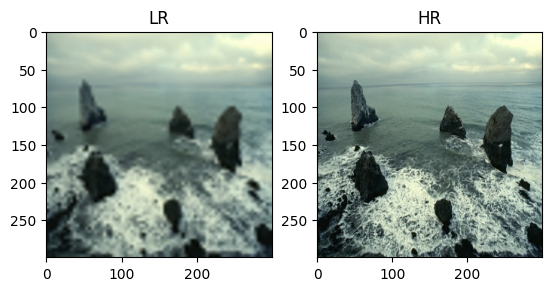

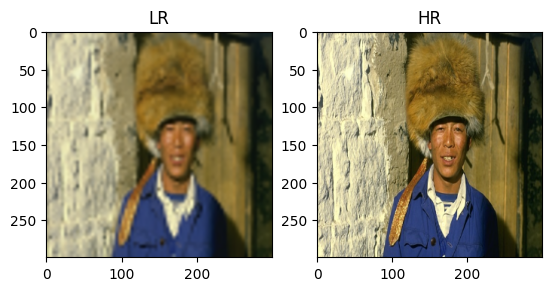

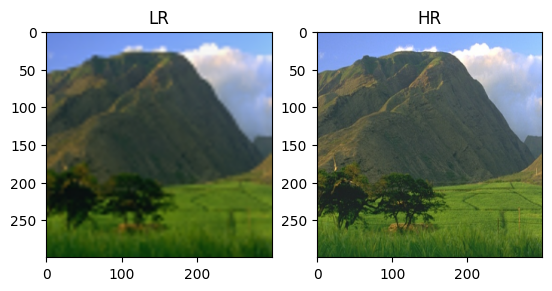

In [8]:
for batch in train_ds.take(1):
    for lr, hr in zip(batch[0], batch[1]):
        plt.subplot(1, 2, 1)
        plt.title("LR")
        plt.imshow(utils.array_to_img(lr))
        
        plt.subplot(1, 2, 2)
        plt.title("HR")
        plt.imshow(utils.array_to_img(hr))
        plt.show()
    # for img in batch[0]:
    #     display(utils.array_to_img(img))
    # for img in batch[1]:
    #     display(utils.array_to_img(img))

# Helper functions

In [9]:
from mpl_toolkits.axes_grid1.inset_locator import zoomed_inset_axes
from mpl_toolkits.axes_grid1.inset_locator import mark_inset
import PIL
import numpy as np


def plot_results(img, prefix, title):
    """Plot the result with zoom-in area."""
    img_array = utils.img_to_array(img)
    img_array = img_array.astype("float32") / 255.0

    # Create a new figure with a default 111 subplot.
    fig, ax = plt.subplots()
    im = ax.imshow(img_array[::-1], origin="lower")

    plt.title(title)
    # zoom-factor: 2.0, location: upper-left
    axins = zoomed_inset_axes(ax, 2, loc=2)
    axins.imshow(img_array[::-1], origin="lower")

    # Specify the limits.
    # x1, x2, y1, y2 = 60, 80, 40, 60
    x1, x2, y1, y2 = 200, 300, 100, 200

    # Apply the x-limits.
    axins.set_xlim(x1, x2)
    # Apply the y-limits.
    axins.set_ylim(y1, y2)

    plt.yticks(visible=False)
    plt.xticks(visible=False)

    # Make the line.
    mark_inset(ax, axins, loc1=1, loc2=3, fc="none", ec="blue")
    plt.savefig(str(prefix) + "-" + title + ".png")
    plt.show()


def get_lowres_image(img, upscale_factor):
    """Return low-resolution image to use as model input."""
    return img.resize(
        (img.size[0] // upscale_factor, img.size[1] // upscale_factor),
        PIL.Image.BICUBIC,
    )


def upscale_image(model, img):
    """Predict the result based on input image and restore the image as RGB."""
    
    y = utils.img_to_array(img)
    y = y.astype("float32") / 255.0

    input = tf.expand_dims(y, axis=0)
    out = model.predict(input)

    out_img_y = out[0]
    # out_img_y *= 255.0
    out_img_y = (out_img_y+1)*127.5

    return out_img_y

In [10]:
root_dir

'/Users/raunavghosh/.keras/datasets/BSR/BSDS500/data'

In [65]:
dataset = os.path.join(root_dir, "images")
test_path = os.path.join(dataset, "test")
# test_path = "/Users/raunavghosh/Documents/DIP/Project/EDRSR/images"

test_img_paths = sorted(
    [
        os.path.join(test_path, fname)
        for fname in os.listdir(test_path)
        if fname.endswith(".jpg")
    ]
)

In [66]:
test_img_paths[:3]

['/Users/raunavghosh/.keras/datasets/BSR/BSDS500/data/images/test/100007.jpg',
 '/Users/raunavghosh/.keras/datasets/BSR/BSDS500/data/images/test/100039.jpg',
 '/Users/raunavghosh/.keras/datasets/BSR/BSDS500/data/images/test/100099.jpg']

# SRResNet

In [67]:
from models import build_discriminator, build_generator, VGG_54, MySRGAN


In [68]:
srresnet = build_generator()
srresnet.load_weights("./SRResNet.h5")
srresnet.summary()

Model: "Generator"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_15 (InputLayer)          [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d_518 (Conv2D)            (None, None, None,   15616       ['input_15[0][0]']               
                                64)                                                               
                                                                                                  
 p_re_lu_266 (PReLU)            (None, None, None,   64          ['conv2d_518[0][0]']             
                                64)                                                       

1/1 [==============================] - 0s 127ms/step
254.49498 18.808596
PSNR of low resolution image and high resolution image is 28.8871
PSNR of predict and high resolution is 30.8641


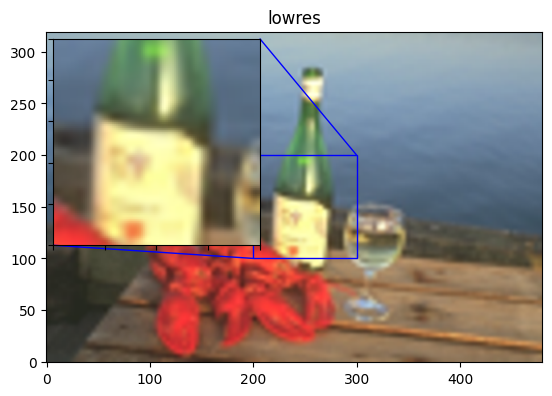

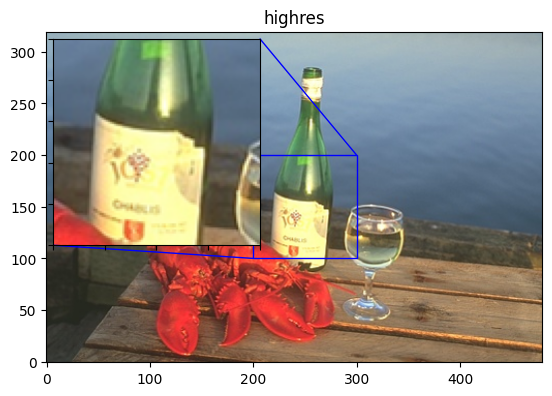

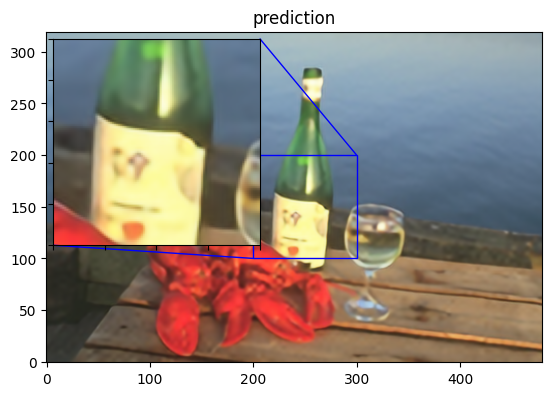

1/1 [==============================] - 0s 22ms/step
254.59702 26.624115
PSNR of low resolution image and high resolution image is 23.7495
PSNR of predict and high resolution is 25.8634


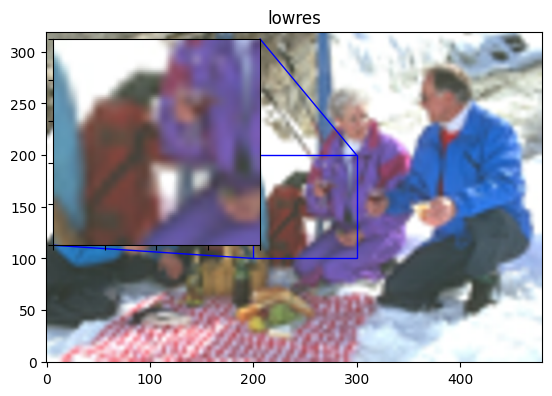

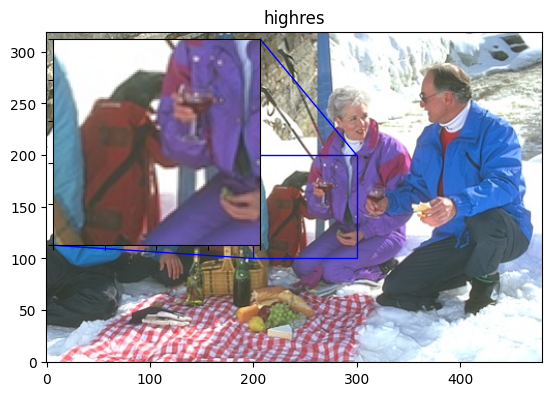

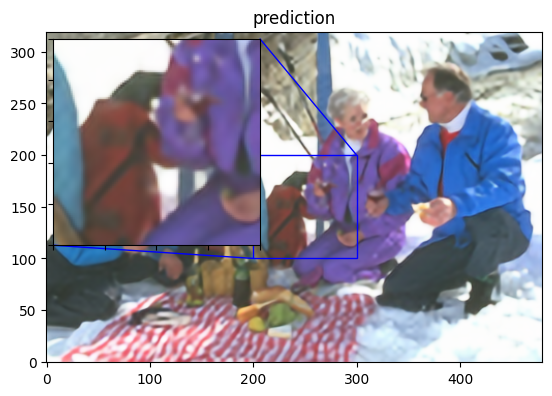

1/1 [==============================] - 0s 48ms/step
253.97853 0.80017626
PSNR of low resolution image and high resolution image is 26.3186
PSNR of predict and high resolution is 27.8976


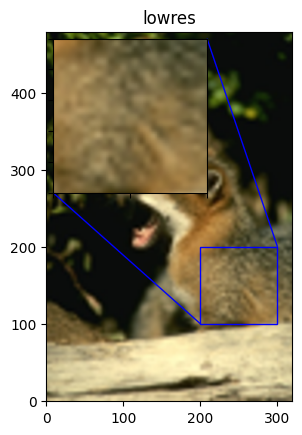

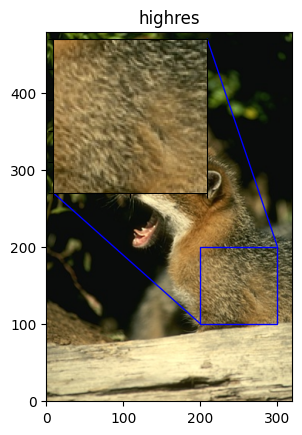

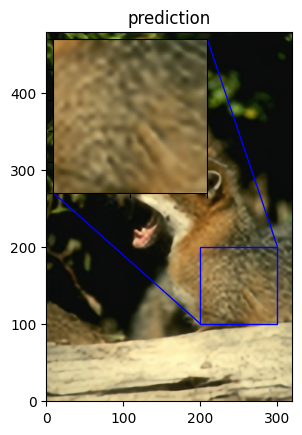

1/1 [==============================] - 0s 22ms/step
222.23187 2.2603922
PSNR of low resolution image and high resolution image is 27.6824
PSNR of predict and high resolution is 28.3339


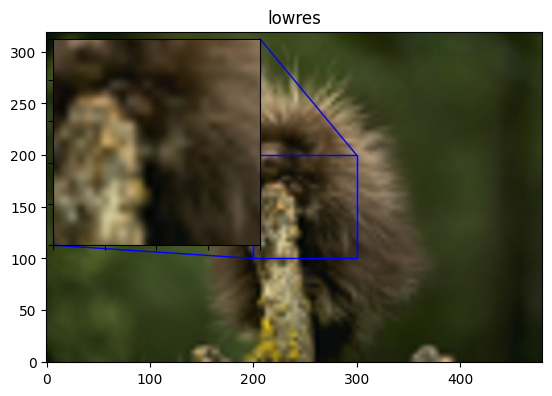

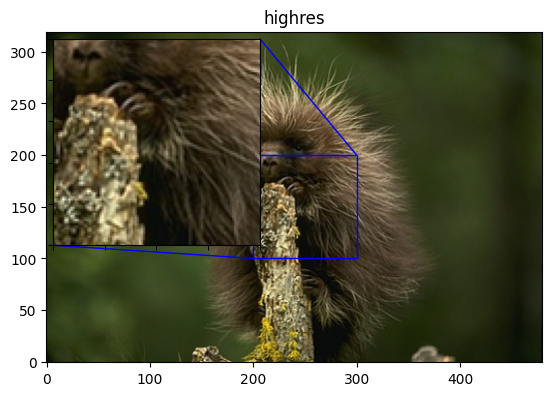

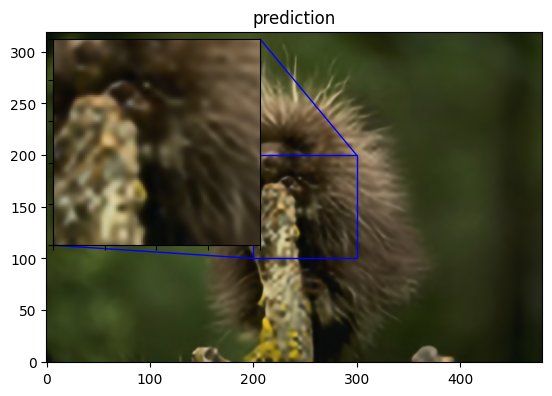

1/1 [==============================] - 0s 26ms/step
254.62015 26.312767
PSNR of low resolution image and high resolution image is 24.7265
PSNR of predict and high resolution is 25.9190


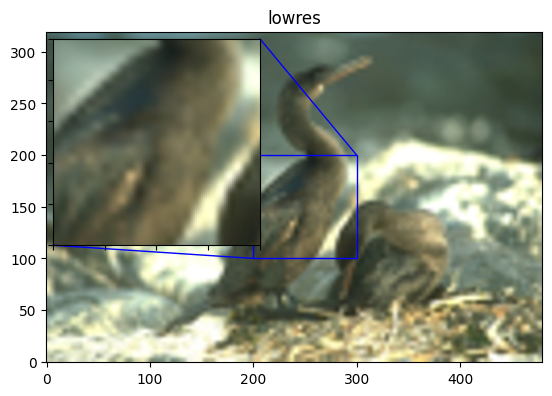

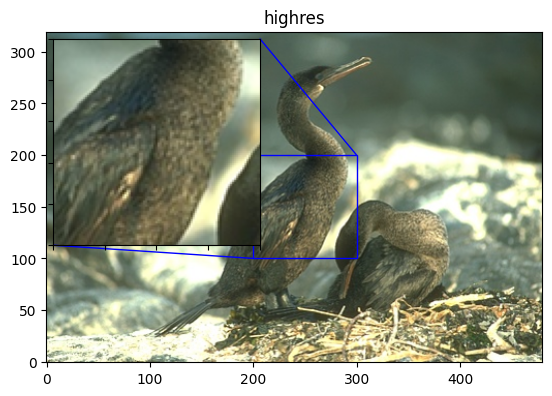

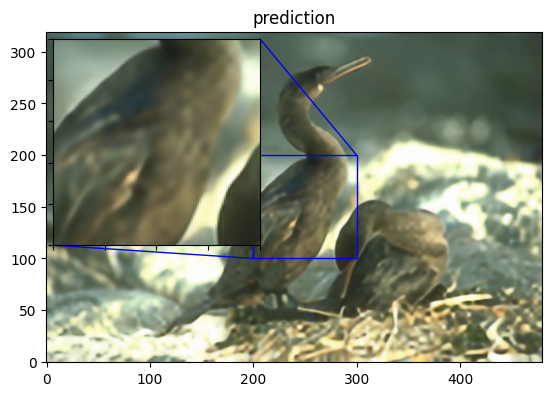

1/1 [==============================] - 0s 31ms/step
254.8242 0.38507894
PSNR of low resolution image and high resolution image is 24.7180
PSNR of predict and high resolution is 26.6466


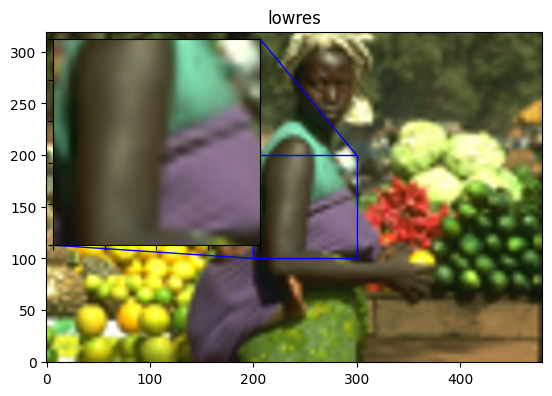

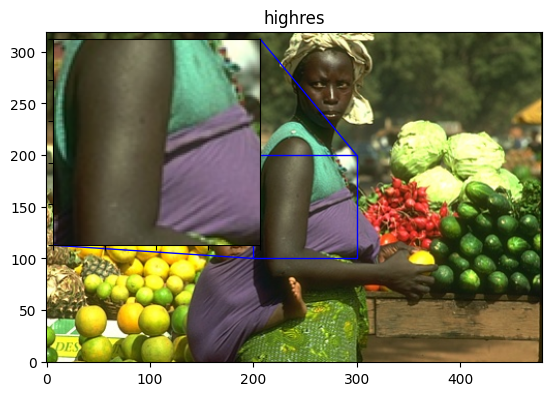

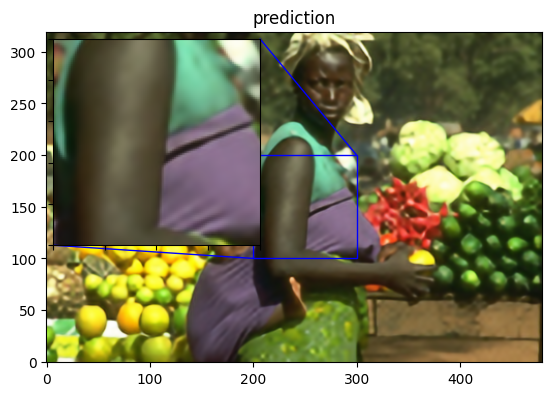

1/1 [==============================] - 0s 22ms/step
254.26115 9.877084
PSNR of low resolution image and high resolution image is 24.7138
PSNR of predict and high resolution is 26.4047


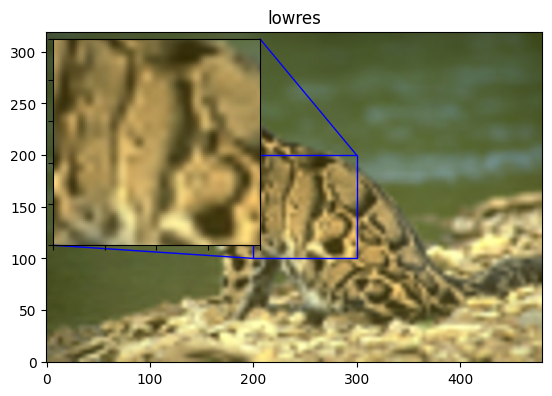

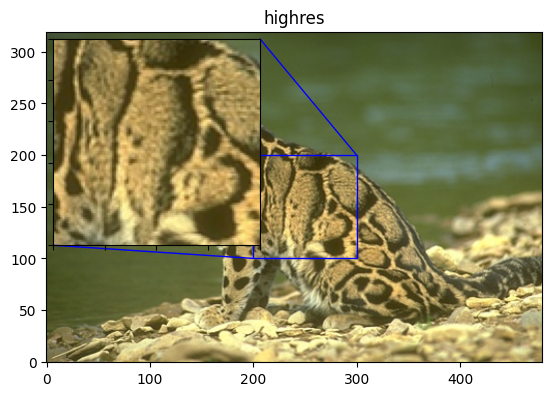

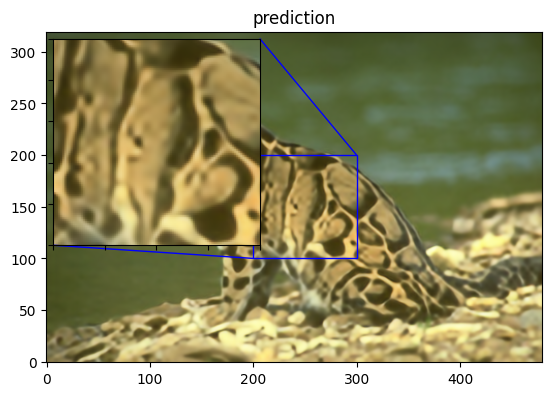

1/1 [==============================] - 0s 33ms/step
248.9872 8.039077
PSNR of low resolution image and high resolution image is 21.9633
PSNR of predict and high resolution is 24.2344


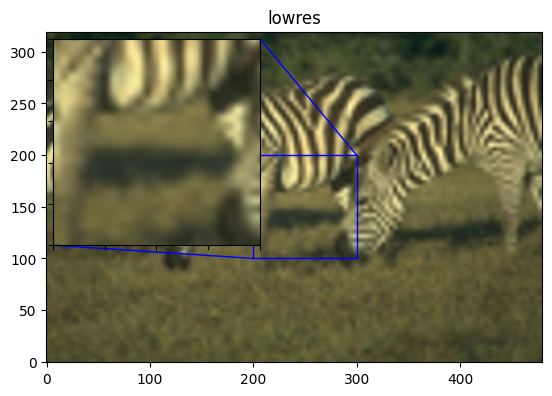

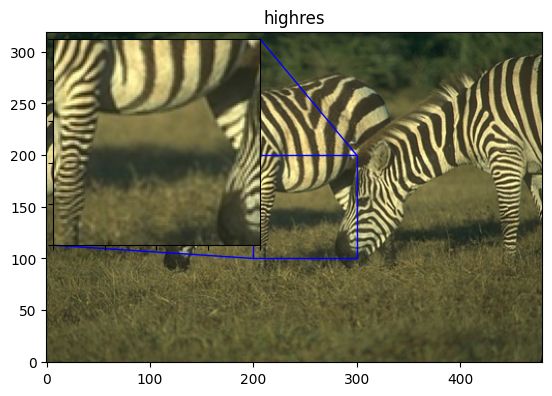

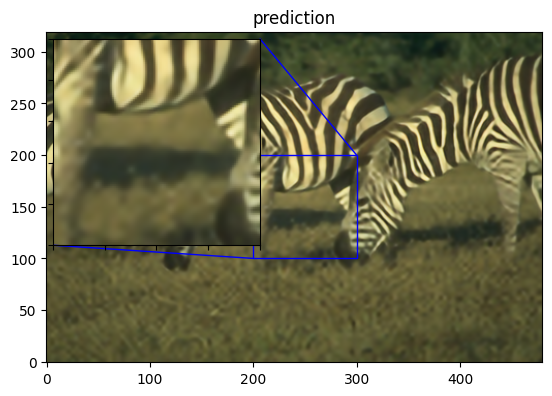

1/1 [==============================] - 0s 38ms/step
185.31593 2.578496
PSNR of low resolution image and high resolution image is 29.4021
PSNR of predict and high resolution is 30.0924


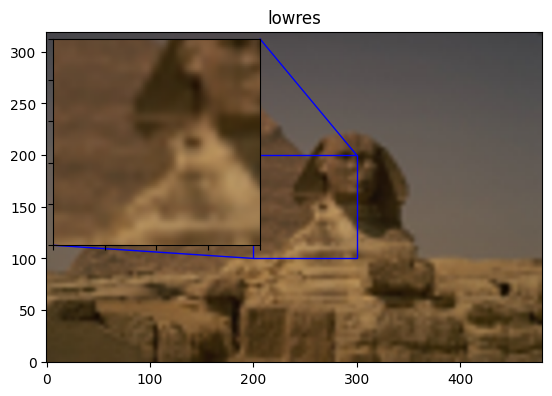

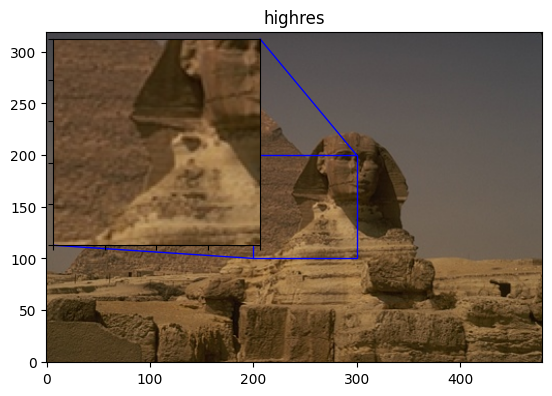

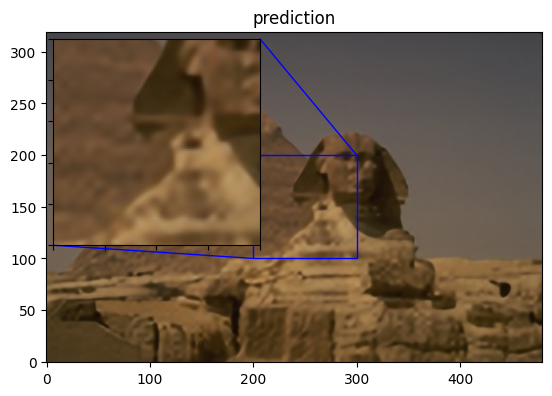

1/1 [==============================] - 0s 78ms/step
254.11073 0.18955663
PSNR of low resolution image and high resolution image is 24.3273
PSNR of predict and high resolution is 25.3822


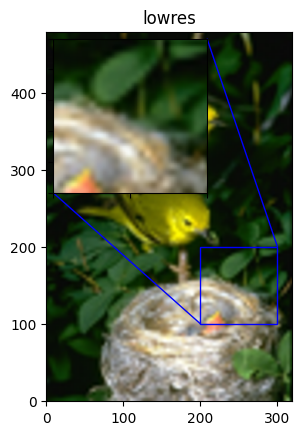

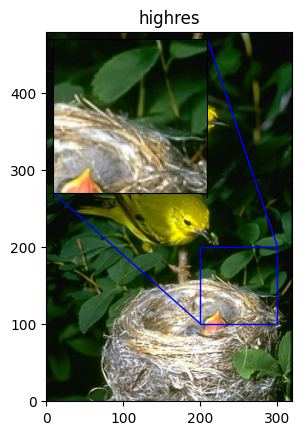

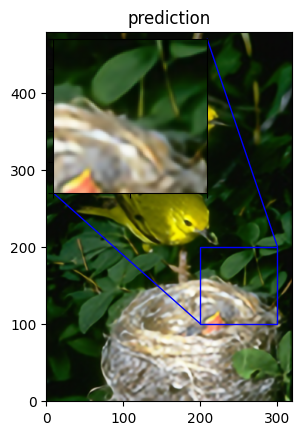

Avg. PSNR of lowres images is 25.6489
Avg. SSIM of lowres images is 0.7686
Avg. PSNR of reconstructions is 27.1638
Avg. SSIM of reconstructions is 0.8278


In [75]:
total_bicubic_psnr = 0.0
total_test_psnr = 0.0
total_bicubic_ssim = 0
total_test_ssim = 0

for index, test_img_path in enumerate(test_img_paths[50:60]):
    img = utils.load_img(test_img_path)
    lowres_input = get_lowres_image(img, upscale_factor)
    w = lowres_input.size[0] * upscale_factor
    h = lowres_input.size[1] * upscale_factor
    highres_img = img.resize((w, h))
    lowres_img = lowres_input.resize((w, h))
    lowres_input_arr = utils.img_to_array(lowres_input)
    prediction = upscale_image(srresnet, lowres_input_arr)
    lowres_img_arr = utils.img_to_array(lowres_img)
    highres_img_arr = utils.img_to_array(highres_img)
    predict_img_arr = utils.img_to_array(prediction)
    print(np.max(predict_img_arr), np.min(predict_img_arr))
    bicubic_psnr = tf.image.psnr(lowres_img_arr, highres_img_arr, max_val=255)
    bicubic_ssim = tf.image.ssim(lowres_img_arr, highres_img_arr, max_val=255)
    # print(lowres_img_arr.shape, highres_img_arr.shape)
    test_psnr = tf.image.psnr(predict_img_arr, highres_img_arr, max_val=255)
    test_ssim = tf.image.ssim(predict_img_arr, highres_img_arr, max_val=255)

    total_bicubic_psnr += bicubic_psnr
    total_test_psnr += test_psnr

    total_bicubic_ssim += bicubic_ssim
    total_test_ssim += test_ssim


    print(
        "PSNR of low resolution image and high resolution image is %.4f" % bicubic_psnr
    )
    print("PSNR of predict and high resolution is %.4f" % test_psnr)
    plot_results(lowres_img, index, "lowres")
    plot_results(highres_img, index, "highres")
    plot_results(prediction, index, "prediction")

print("Avg. PSNR of lowres images is %.4f" % (total_bicubic_psnr / 10))
print("Avg. SSIM of lowres images is %.4f" % (total_bicubic_ssim / 10))
print("Avg. PSNR of reconstructions is %.4f" % (total_test_psnr / 10))
print("Avg. SSIM of reconstructions is %.4f" % (total_test_ssim / 10))

# SRGAN

In [70]:
from models import build_discriminator, build_generator, VGG_54, MySRGAN

In [71]:
crop_size = 96
srgan = build_generator()
srgan.load_weights("./SRGAN-generator.h5")
# generator = srgan.generator
srgan.summary() # this just the generator

Model: "Generator"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_16 (InputLayer)          [(None, None, None,  0           []                               
                                 3)]                                                              
                                                                                                  
 conv2d_555 (Conv2D)            (None, None, None,   15616       ['input_16[0][0]']               
                                64)                                                               
                                                                                                  
 p_re_lu_285 (PReLU)            (None, None, None,   64          ['conv2d_555[0][0]']             
                                64)                                                       

1/1 [==============================] - 0s 82ms/step
254.44675 13.942721
PSNR of low resolution image and high resolution image is 28.8871
PSNR of predict and high resolution is 28.3525


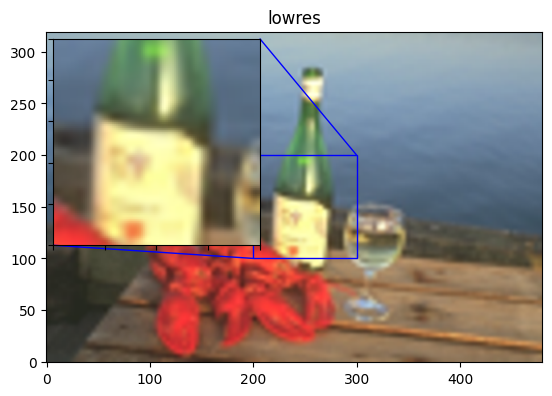

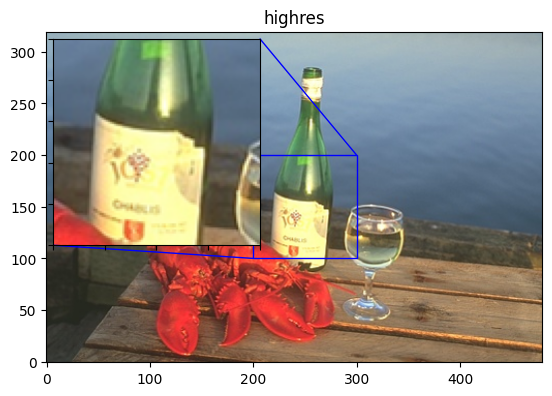

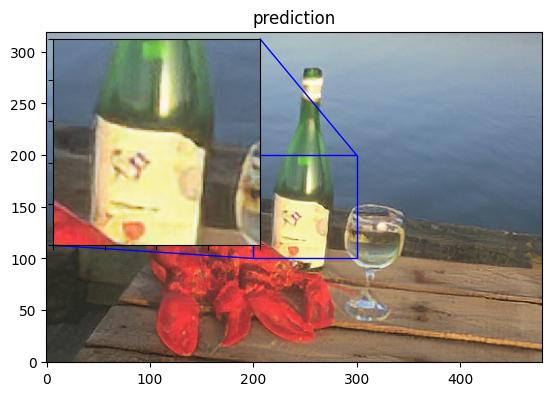

1/1 [==============================] - 0s 33ms/step
254.65225 22.165821
PSNR of low resolution image and high resolution image is 23.7495
PSNR of predict and high resolution is 23.7211


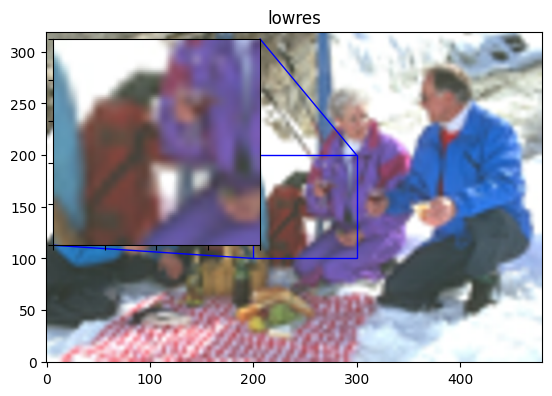

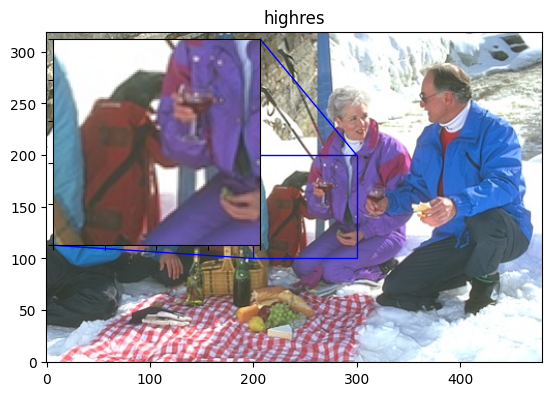

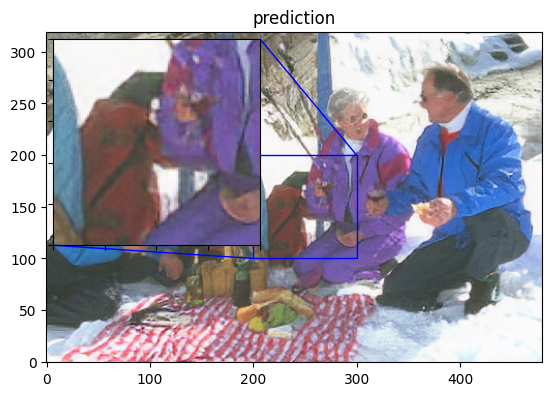

1/1 [==============================] - 0s 57ms/step
252.29228 0.3837262
PSNR of low resolution image and high resolution image is 26.3186
PSNR of predict and high resolution is 24.8630


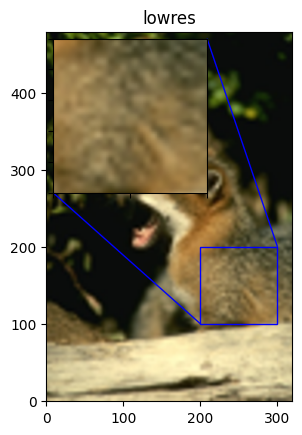

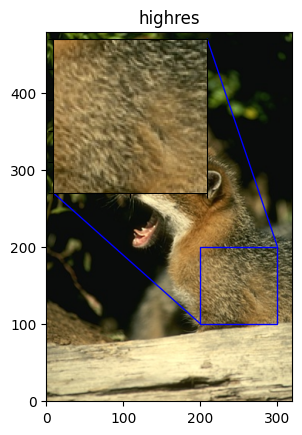

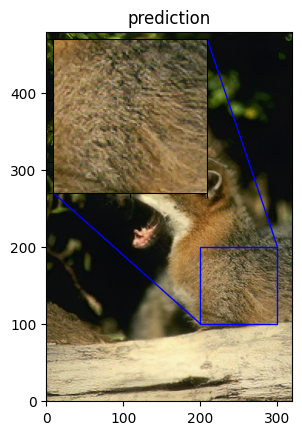

1/1 [==============================] - 0s 22ms/step
239.78802 2.362964
PSNR of low resolution image and high resolution image is 27.6824
PSNR of predict and high resolution is 26.2679


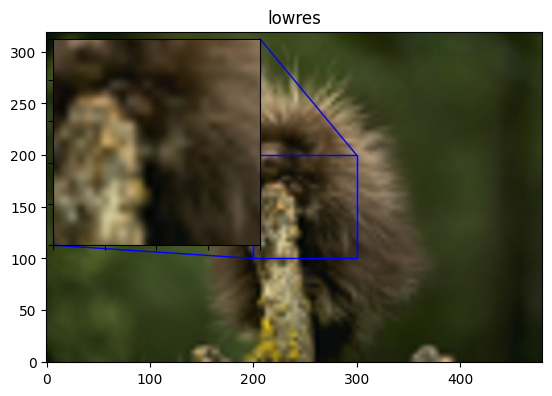

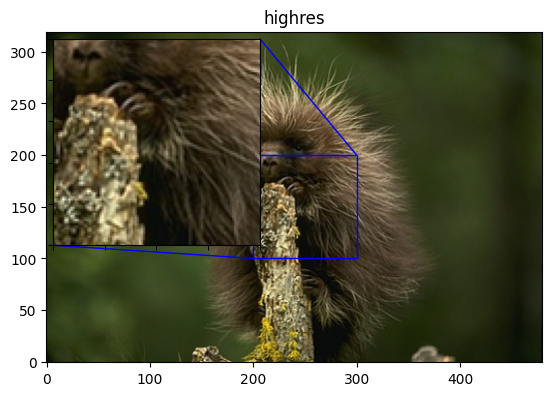

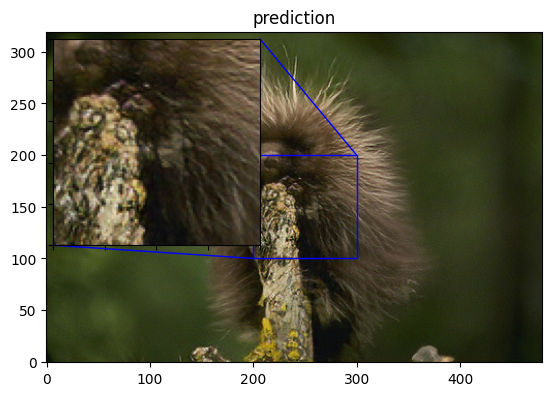

1/1 [==============================] - 0s 39ms/step
254.49834 12.859125
PSNR of low resolution image and high resolution image is 24.7265
PSNR of predict and high resolution is 23.5337


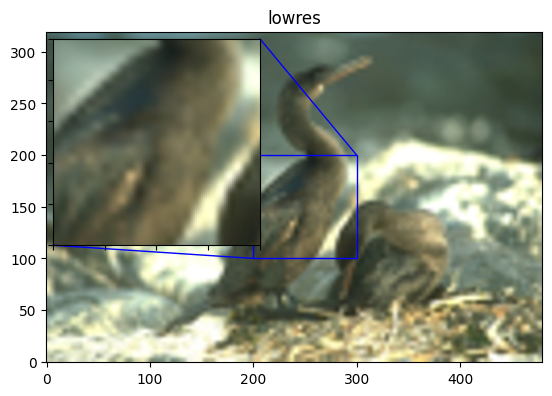

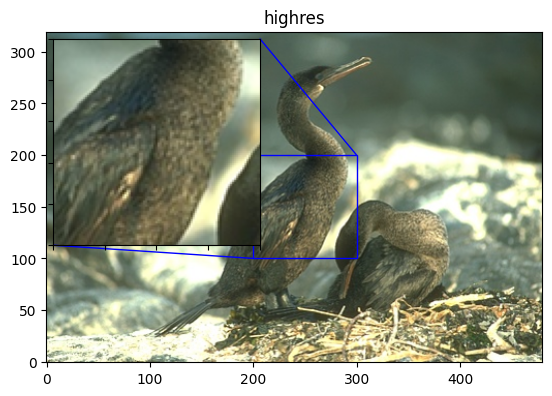

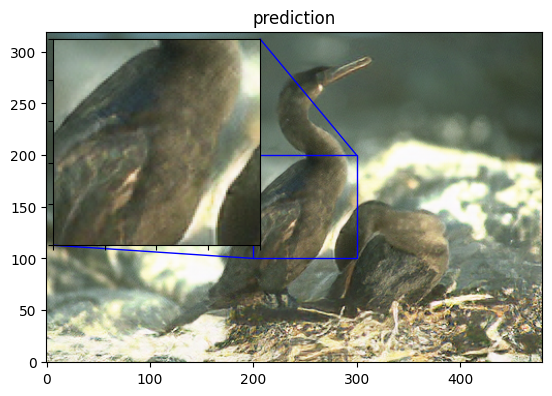

1/1 [==============================] - 0s 22ms/step
253.9579 0.48420042
PSNR of low resolution image and high resolution image is 24.7180
PSNR of predict and high resolution is 24.7231


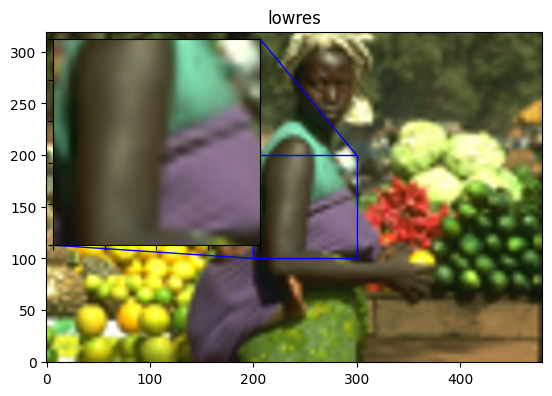

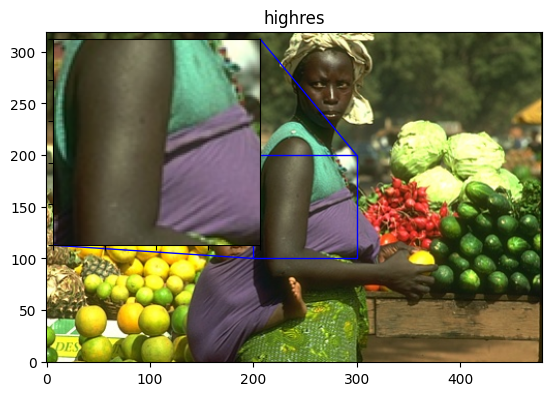

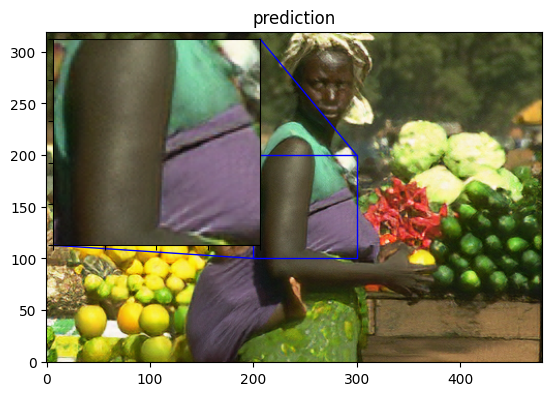

1/1 [==============================] - 0s 22ms/step
253.19029 8.043203
PSNR of low resolution image and high resolution image is 24.7138
PSNR of predict and high resolution is 23.8580


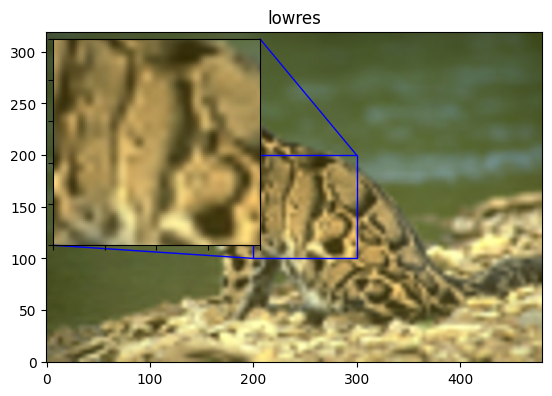

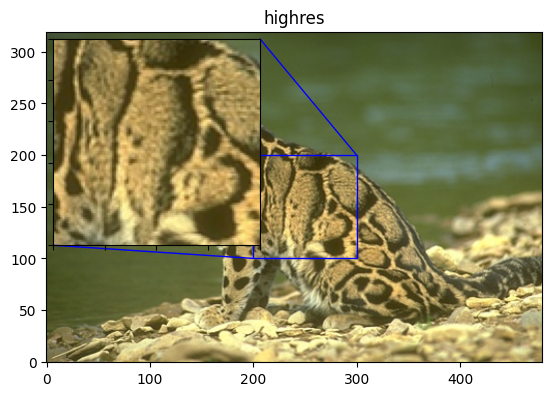

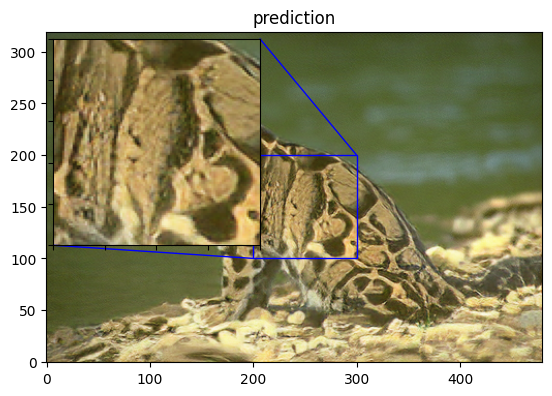

1/1 [==============================] - 0s 21ms/step
253.8171 6.329024
PSNR of low resolution image and high resolution image is 21.9633
PSNR of predict and high resolution is 22.1133


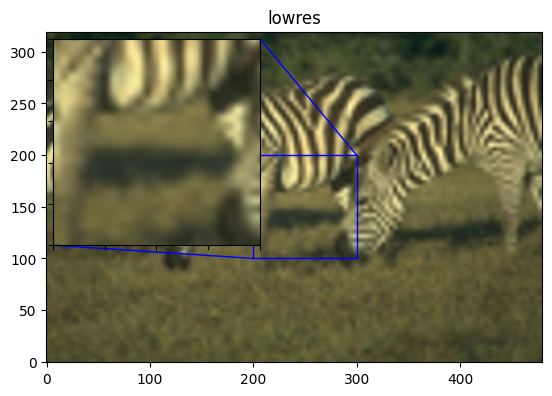

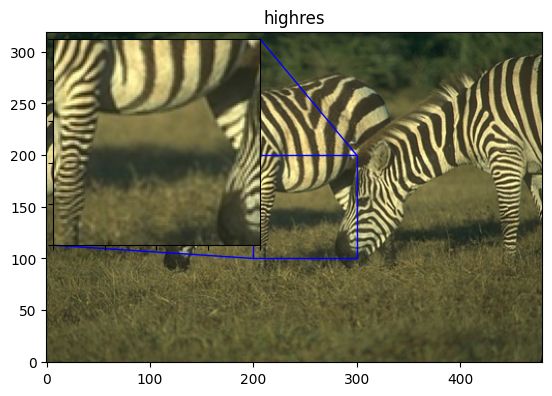

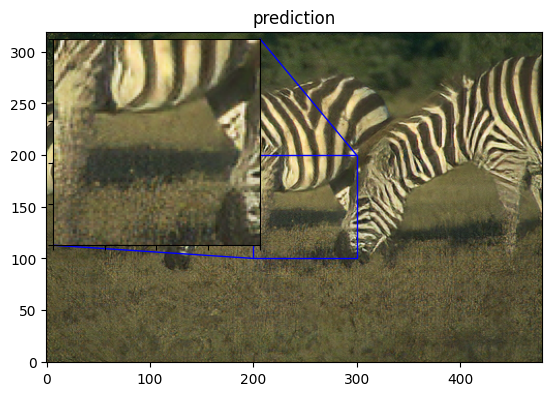

1/1 [==============================] - 0s 22ms/step
214.7856 1.7704618
PSNR of low resolution image and high resolution image is 29.4021
PSNR of predict and high resolution is 27.4504


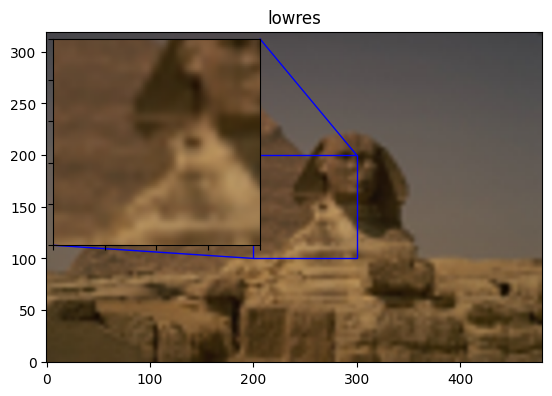

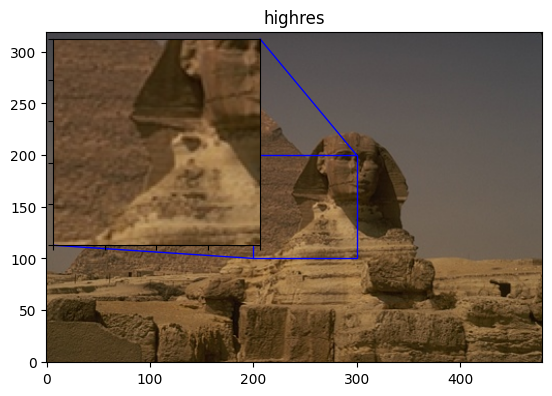

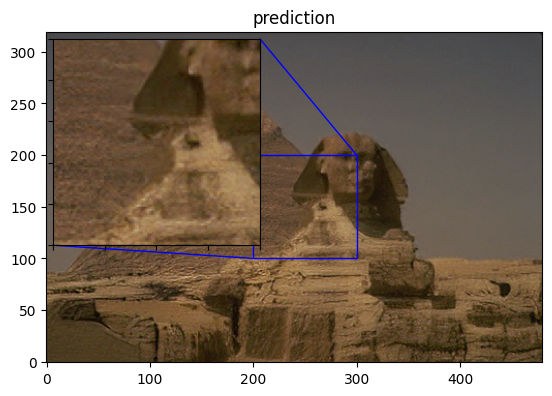

1/1 [==============================] - 0s 25ms/step
253.31046 0.3222911
PSNR of low resolution image and high resolution image is 24.3273
PSNR of predict and high resolution is 23.1659


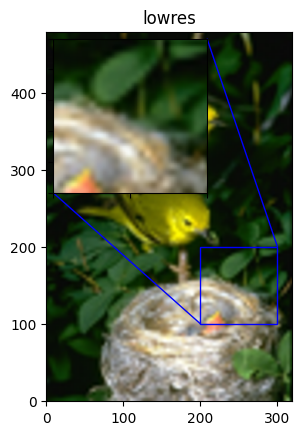

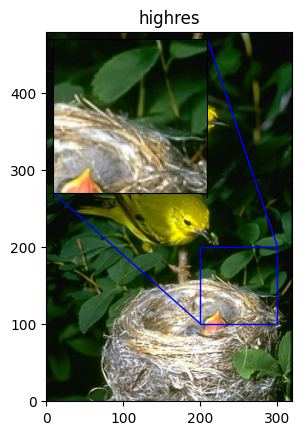

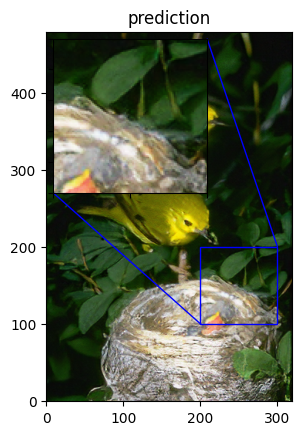

Avg. PSNR of lowres images is 25.6489
Avg. SSIM of lowres images is 0.7686
Avg. PSNR of reconstructions is 24.8049
Avg. SSIM of reconstructions is 0.7383


In [74]:
total_bicubic_psnr = 0.0
total_test_psnr = 0.0
total_bicubic_ssim = 0
total_test_ssim = 0

for index, test_img_path in enumerate(test_img_paths[50:60]):
    img = utils.load_img(test_img_path)
    lowres_input = get_lowres_image(img, upscale_factor)
    w = lowres_input.size[0] * upscale_factor
    h = lowres_input.size[1] * upscale_factor
    highres_img = img.resize((w, h))
    lowres_img = lowres_input.resize((w, h))
    lowres_input_arr = utils.img_to_array(lowres_input)
    prediction = upscale_image(srgan, lowres_input_arr)
    lowres_img_arr = utils.img_to_array(lowres_img)
    highres_img_arr = utils.img_to_array(highres_img)
    predict_img_arr = utils.img_to_array(prediction)
    print(np.max(predict_img_arr), np.min(predict_img_arr))
    bicubic_psnr = tf.image.psnr(lowres_img_arr, highres_img_arr, max_val=255)
    bicubic_ssim = tf.image.ssim(lowres_img_arr, highres_img_arr, max_val=255)
    # print(lowres_img_arr.shape, highres_img_arr.shape)
    test_psnr = tf.image.psnr(predict_img_arr, highres_img_arr, max_val=255)
    test_ssim = tf.image.ssim(predict_img_arr, highres_img_arr, max_val=255)

    total_bicubic_psnr += bicubic_psnr
    total_test_psnr += test_psnr

    total_bicubic_ssim += bicubic_ssim
    total_test_ssim += test_ssim


    print(
        "PSNR of low resolution image and high resolution image is %.4f" % bicubic_psnr
    )
    print("PSNR of predict and high resolution is %.4f" % test_psnr)
    plot_results(lowres_img, index, "lowres")
    plot_results(highres_img, index, "highres")
    plot_results(prediction, index, "prediction")

print("Avg. PSNR of lowres images is %.4f" % (total_bicubic_psnr / 10))
print("Avg. SSIM of lowres images is %.4f" % (total_bicubic_ssim / 10))
print("Avg. PSNR of reconstructions is %.4f" % (total_test_psnr / 10))
print("Avg. SSIM of reconstructions is %.4f" % (total_test_ssim / 10))